<a href="https://colab.research.google.com/github/chiheb764/ObjectDetection/blob/main/Olives_(1).ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!python -m pip install pyyaml==5.1
!python -m pip install 'git+https://github.com/facebookresearch/detectron2.git'

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 274.2/274.2 kB 6.2 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for pyyaml: filename=PyYAML-5.1-cp310-cp310-linux_x86_64.whl size=44090 sha256=0689605cebbf805d777be45a4ab53679b37c9de0bdc09ddfabda27350b3088ad
  Stored in directory: /root/.cache/pip/wheels/70/83/31/975b737609aba39a4099d471d5684141c1fdc3404f97e7f68a
Successfully built pyyaml
  Attempting uninstall: pyyaml
    Found existing installation: PyYAML 6.0
    Uninstalling PyYAML-6.0:
      Successfully uninstalled PyYAML-6.0
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
dask 2022.12.1 requires pyyaml>=5.3.1, but you have pyyaml 5.1 which is incompatible.
flax 0.6.9 requires PyYAML>=5.4.1, but you have pyyaml 5.1 which is incompatibl

In [ ]:
import torch, detectron2
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()
from detectron2.utils.visualizer import ColorMode
import numpy as np
import os, json, cv2, random
from google.colab.patches import cv2_imshow
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog, DatasetCatalog
from google.colab import drive
from detectron2.data.datasets import register_coco_instances
from detectron2.structures import BoxMode
import math
from shapely.geometry import Point, LineString
from shapely.affinity import scale, rotate
from matplotlib import pyplot as plt
from detectron2.engine import DefaultTrainer
from shapely.geometry import Polygon



In [ ]:
from google.colab import drive
drive.mount("/content/drive", force_remount=True)

Mounted at /content/drive


In [ ]:
register_coco_instances("my_dataset_train", {}, "/content/drive/MyDrive/bd_train1/BDD.json", "/content/drive/MyDrive/bd_train1")

In [ ]:
def get_olive_dicts(img_dir):
    json_file = os.path.join(img_dir, "BDD.json")
    with open(json_file) as f:
        imgs_anns = json.load(f)

    dataset_dicts = []
    for idx, v in enumerate(imgs_anns.values()):
        record = {}

        # Get the image file name and read the image
        filename = os.path.join(img_dir, v["filename"])
        img = cv2.imread(filename)


        # Get the height and width of the image
        height, width = img.shape[:2]

        # Add the image file name, image ID, height, and width to the record
        record["file_name"] = filename
        record["image_id"] = idx
        record["height"] = height
        record["width"] = width

        # Get the annotations (regions) for this image
        annos = v["regions"]
        objs = []
        for anno in annos:
            # Get the type of the annotation
            anno_type = anno["shape_attributes"]["name"]

            # Get the shape attributes of the annotation
            anno_shape = anno["shape_attributes"]

            # Parse the ellipse annotation
            if anno_type == "ellipse":
                cx = anno_shape["cx"]
                cy = anno_shape["cy"]
                rx = anno_shape["rx"]
                ry = anno_shape["ry"]
                theta = -anno_shape["theta"]

                # Calculate the ellipse coordinates using Shapely
                A = Point(cx-rx, cy)
                B = Point(cx+rx, cy)
                R = ry
                d = A.distance(B)
                S = Point(cx, cy)
                LOS = LineString([(A.x, A.y), (B.x, B.y)])
                C = S.buffer(d/2)
                C = scale(C, 0.75, R/(d/2))
                C = rotate(C, theta, origin=S, use_radians=True)
                f_x, f_y = C.exterior.xy
                px = f_x
                py = f_y

                # Create the object dictionary
                obj = {
                    "bbox": [np.min(px), np.min(py), np.max(px), np.max(py)],
                    "bbox_mode": BoxMode.XYXY_ABS,
                    "segmentation": [np.array([px, py]).T.ravel().tolist()],
                    "category_id": 0,  # Olive
                }

            # Parse the polyline annotation
            elif anno_type == "polyline":
                px = anno_shape["all_points_x"]
                py = anno_shape["all_points_y"]
                 # Ignore the polyline if it has less than 4 coordinates
                if len(px) < 4 or len(py) < 4:
                    continue

                num_polylines = 1
                segmentation = []
                segmentation.append(np.stack((px, py), axis=1).ravel().tolist())
                # Create the object dictionary
                obj = {
                    "bbox": [np.min(px), np.min(py), np.max(px), np.max(py)],
                    "bbox_mode": BoxMode.XYXY_ABS,
                    "segmentation": segmentation,
                    "category_id": 1,  # Leaf
                }
            # Add the object to the list of objects
            objs.append(obj)

        # Add the list of objects to the record
        record["annotations"] = objs

        # Add the record to the dataset dictionary
        dataset_dicts.append(record)

    return dataset_dicts

In [ ]:
DatasetCatalog.register("Olive_trainn", lambda d="Train": get_olive_dicts("/content/drive/MyDrive/bd_train1"))
MetadataCatalog.get("Olive_trainn").set(thing_classes=["olive", "leaf"])
olive_metadata = MetadataCatalog.get("Olive_trainn")


In [ ]:

cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml"))
cfg.DATASETS.TRAIN = ("Olive_trainn",)
cfg.DATASETS.TEST = ()
cfg.DATALOADER.NUM_WORKERS = 2
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml")  # Let training initialize from model zoo
cfg.SOLVER.IMS_PER_BATCH = 2  # This is the real "batch size" commonly known to deep learning people
cfg.SOLVER.BASE_LR = 0.00025  # pick a good LR
cfg.SOLVER.MAX_ITER = 600   # 300 iterations seems good enough for this toy dataset; you will need to train longer for a practical dataset
cfg.SOLVER.STEPS = []        # do not decay learning rate
cfg.OUTPUT_DIR = "/content/drive/MyDrive/output"
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 128   # The "RoIHead batch size". 128 is faster, and good enough for this olive dataset (default: 512)
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 2  # only has o+ne class (olive). (see https://detectron2.readthedocs.io/tutorials/datasets.html#update-the-config-for-new-datasets)
# NOTE: this config means the number of classes, but a few popular unofficial tutorials incorrect uses num_classes+1 here.

#os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)
#trainer = DefaultTrainer(cfg)

#trainer.resume_or_load(resume=False)
#trainer.train()


In [ ]:
# Look at training curves in tensorboard:
%load_ext tensorboard
%tensorboard --logdir /content/drive/MyDrive/output


<IPython.core.display.Javascript object>

In [ ]:
# Inference should use the config with parameters that are used in training
# cfg now already contains everything we've set previously. We changed it a little bit for inference:
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")  # path to the model we just trained
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.3   # set a custom testing threshold
predictor = DefaultPredictor(cfg)

[06/02 13:37:00 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from /content/drive/MyDrive/output/model_final.pth ...


In [ ]:
#register_coco_instances("olive_val", {}, "/content/drive/MyDrive/bd_test/BD_CRNS_json (2).json", "/content/drive/MyDrive/bd_test")

In [ ]:
DatasetCatalog.register("Olive_val", lambda d="Test": get_olive_dicts("/content/drive/MyDrive/bd_test1"))
MetadataCatalog.get("Olive_val").set(thing_classes=["olive","leaf"])


namespace(name='Olive_val', thing_classes=['olive', 'leaf'])

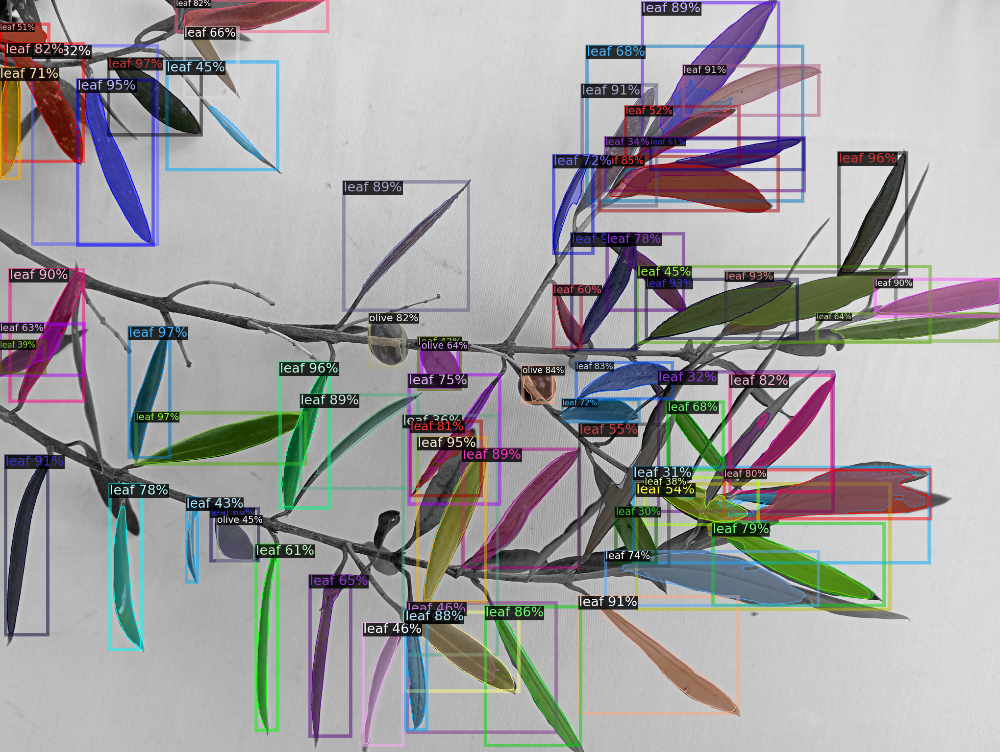

In [ ]:
dataset_dicts = get_olive_dicts("/content/drive/MyDrive/bd_test1")
for d in random.sample(dataset_dicts, 1):

    im = cv2.imread(d["file_name"])
    outputs = predictor(im)  # format is documented at https://detectron2.readthedocs.io/tutorials/models.html#model-output-format
    v = Visualizer(im[:, :, ::-1],
                   metadata=olive_metadata,
                   scale=0.5,
                   instance_mode=ColorMode.IMAGE_BW   # remove the colors of unsegmented pixels. This option is only available for segmentation models
    )
    out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    cv2_imshow(out.get_image()[:, :, ::-1])

/usr/local/lib/python3.10/dist-packages/torch/functional.py:504: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at ../aten/src/ATen/native/TensorShape.cpp:3483.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


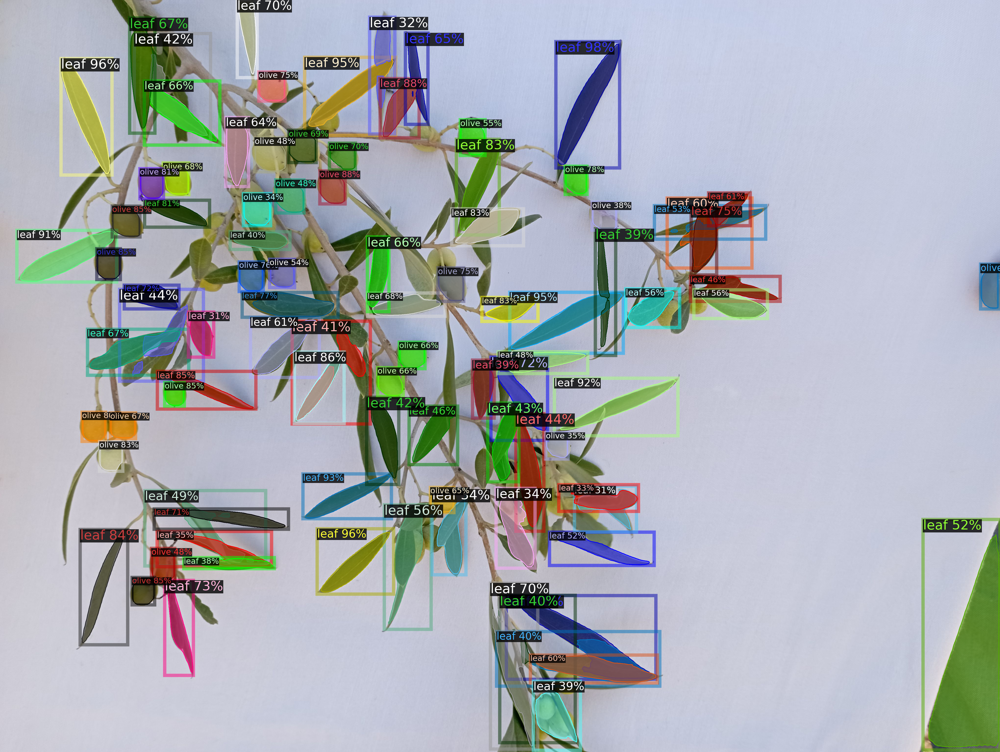

In [ ]:
from detectron2.utils.visualizer import Visualizer
from google.colab.patches import cv2_imshow

# Load the model
# ...

# Define a list of image paths to process
image_paths = [
    "/content/drive/MyDrive/testt1/IMG_20221105_101755à.jpg",
   # ...
]

# Process each image and visualize the results
for image_path in image_paths:
    # Load the image
    img = cv2.imread(image_path)

    # Make predictions on the image
    outputs = predictor(img)

    # Create a visualizer object
    v = Visualizer(img[:, :, ::-1], olive_metadata, scale=1)

    # Draw the predicted bounding boxes and labels on the image
    out = v.draw_instance_predictions(outputs["instances"].to("cpu"))

    # Show the image with the predicted bounding boxes and labels
    cv2_imshow(out.get_image()[:, :, ::-1])
    cv2.waitKey(0)

# Close all windows
cv2.destroyAllWindows()

In [ ]:
seuils_confiance = [0.3, 0.35, 0.40, 0.45,0.5,0.55,0.60,0.65,0.7]
for seuil_confiance in seuils_confiance:
  cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = seuil_confiance
  predictor = DefaultPredictor(cfg)
  outputs = predictor(img)

  masque_feuilles = outputs["instances"].pred_masks[outputs["instances"].pred_classes == 1]
  masque_olives = outputs["instances"].pred_masks[outputs["instances"].pred_classes == 0]

  # Calcul de la surface segmentée des feuilles
  surface_feuilles = torch.sum(masque_feuilles).item()

# Calcul de la surface segmentée des olives
  surface_olives = torch.sum(masque_olives).item()

# Calcul du rapport entre la surface des feuilles et la surface des olives
  rapport_segmentation = surface_feuilles / surface_olives

# Affichage du résultat
  print("Le rapport de segmentation (seuil de confiance =", seuil_confiance, ") est de :", rapport_segmentation)

[05/25 20:54:36 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from /content/drive/MyDrive/output/model_final.pth ...
Le rapport de segmentation (seuil de confiance = 0.3 ) est de : 5.086857664169547
[05/25 20:54:39 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from /content/drive/MyDrive/output/model_final.pth ...
Le rapport de segmentation (seuil de confiance = 0.35 ) est de : 4.937010384071406
[05/25 20:54:42 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from /content/drive/MyDrive/output/model_final.pth ...
Le rapport de segmentation (seuil de confiance = 0.4 ) est de : 4.966553837494724
[05/25 20:54:44 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from /content/drive/MyDrive/output/model_final.pth ...
Le rapport de segmentation (seuil de confiance = 0.45 ) est de : 4.235831209643377
[05/25 20:54:46 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from /content/drive/MyDri

In [ ]:
10000*4/3*3.14*(0.005)**3*1000*0.3*20

31.400000000000006

In [ ]:
10000*4/3*3.14*(0.005)**3*1000*0.9

4.710000000000001

In [ ]:
from detectron2.evaluation import COCOEvaluator, inference_on_dataset
from detectron2.data import build_detection_test_loader
evaluator = COCOEvaluator("Olive_val", output_dir="/content/drive/MyDrive/output")
val_loader = build_detection_test_loader(cfg,"Olive_val")
print(inference_on_dataset(predictor.model, val_loader, evaluator))
# another equivalent way to evaluate the model is to use `trainer.test

[06/02 13:37:55 d2.evaluation.coco_evaluation]: Trying to convert 'Olive_val' to COCO format ...
[06/02 13:37:55 d2.data.datasets.coco]: Converting annotations of dataset 'Olive_val' to COCO format ...)
[06/02 13:38:41 d2.data.datasets.coco]: Converting dataset dicts into COCO format
[06/02 13:38:42 d2.data.datasets.coco]: Conversion finished, #images: 23, #annotations: 1173
[06/02 13:38:42 d2.data.datasets.coco]: Caching COCO format annotations at '/content/drive/MyDrive/output/Olive_val_coco_format.json' ...
[06/02 13:38:48 d2.data.build]: Distribution of instances among all 2 categories:
|  category  | #instances   |  category  | #instances   |
|:----------:|:-------------|:----------:|:-------------|
|   olive    | 213          |    leaf    | 960          |
|            |              |            |              |
|   total    | 1173         |            |              |
[06/02 13:38:48 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(sh

/usr/local/lib/python3.10/dist-packages/torch/functional.py:504: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at ../aten/src/ATen/native/TensorShape.cpp:3483.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


[06/02 13:39:31 d2.evaluation.evaluator]: Inference done 11/23. Dataloading: 0.0023 s/iter. Inference: 0.3420 s/iter. Eval: 3.0342 s/iter. Total: 3.3785 s/iter. ETA=0:00:40
[06/02 13:39:37 d2.evaluation.evaluator]: Inference done 14/23. Dataloading: 0.0025 s/iter. Inference: 0.3151 s/iter. Eval: 2.5665 s/iter. Total: 2.8846 s/iter. ETA=0:00:25
[06/02 13:39:42 d2.evaluation.evaluator]: Inference done 17/23. Dataloading: 0.0027 s/iter. Inference: 0.2900 s/iter. Eval: 2.3058 s/iter. Total: 2.5991 s/iter. ETA=0:00:15
[06/02 13:39:50 d2.evaluation.evaluator]: Inference done 20/23. Dataloading: 0.0033 s/iter. Inference: 0.2871 s/iter. Eval: 2.3252 s/iter. Total: 2.6162 s/iter. ETA=0:00:07
[06/02 13:39:58 d2.evaluation.evaluator]: Inference done 23/23. Dataloading: 0.0030 s/iter. Inference: 0.2856 s/iter. Eval: 2.3178 s/iter. Total: 2.6069 s/iter. ETA=0:00:00
[06/02 13:39:58 d2.evaluation.evaluator]: Total inference time: 0:00:47.026151 (2.612564 s / iter per device, on 1 devices)
[06/02 13:3

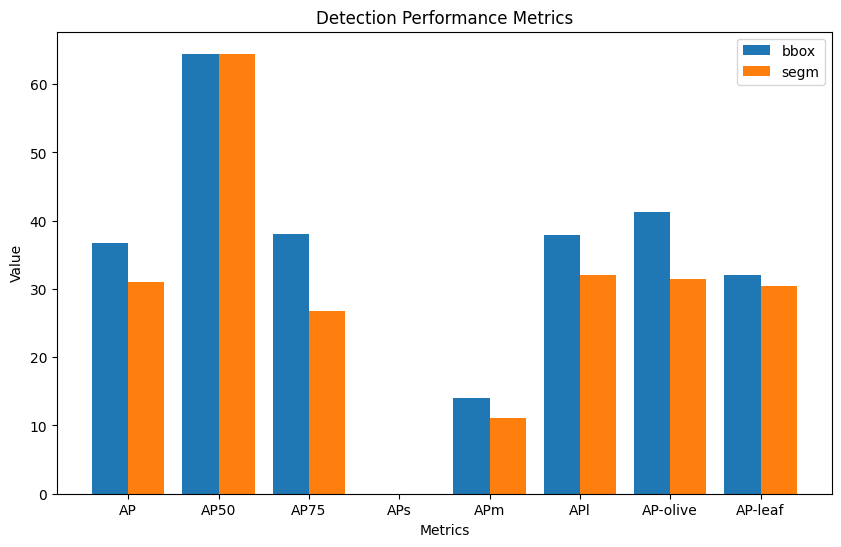

In [ ]:
#results = inference_on_dataset(predictor.model, val_loader, evaluator)
import matplotlib.pyplot as plt
from collections import OrderedDict

results = OrderedDict([('bbox', {'AP': 36.69576533131623, 'AP50': 64.39247221161794, 'AP75': 38.04887460865272, 'APs': float('nan'), 'APm': 13.960396039603962, 'APl': 37.92927432150353, 'AP-olive': 41.30802345221765, 'AP-leaf': 32.08350721041484}), ('segm', {'AP': 30.966263534564497, 'AP50': 64.46078481507446, 'AP75': 26.702031813521632, 'APs': float('nan'), 'APm': 11.035478547854785, 'APl': 32.07585385668362, 'AP-olive': 31.495496908150272, 'AP-leaf': 30.437030160978722})])

metrics = ['AP', 'AP50', 'AP75', 'APs', 'APm', 'APl', 'AP-olive', 'AP-leaf']
values_bbox = [results['bbox'][m] for m in metrics]
values_segm = [results['segm'][m] for m in metrics]

# Plot the values
x = range(len(metrics))
plt.figure(figsize=(10, 6))
plt.bar(x, values_bbox, width=0.4, align='center', label='bbox')
plt.bar([i + 0.4 for i in x], values_segm, width=0.4, align='center', label='segm')
plt.xticks([i + 0.2 for i in x], metrics)
plt.xlabel('Metrics')
plt.ylabel('Value')
plt.title('Detection Performance Metrics')
plt.legend()
plt.show()



In [ ]:

dataset_dicts = get_olive_dicts("/content/drive/MyDrive/bd_test1")
for d in random.sample(dataset_dicts, 1):

    im = cv2.imread(d["file_name"])
    outputs = predictor(im)  # format is documented at https://detectron2.readthedocs.io/tutorials/models.html#model-output-format
    v = Visualizer(im[:, :, ::-1],
                   metadata=olive_metadata,
                   scale=0.5,
                   instance_mode=ColorMode.IMAGE_BW   # remove the colors of unsegmented pixels. This option is only available for segmentation models
    )
    out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    cv2_imshow(out.get_image()[:, :, ::-1])

In [ ]:
img_path = "/content/drive/MyDrive/bd_test1/IMG_20220116_093715.jpg"

In [ ]:
im = cv2.imread('/content/drive/MyDrive/bd_test1/IMG_20220116_094227.jpg')
outputs = predictor(im)
v = Visualizer(im[:, :, ::-1],
                   metadata=olive_metadata,
                   scale=0.5,
                   instance_mode=ColorMode.IMAGE_BW   # remove the colors of unsegmented pixels. This option is only available for segmentation models
    )
out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
cv2_imshow(out.get_image()[:, :, ::-1])

In [ ]:
outputs

{'instances': Instances(num_instances=24, image_height=3072, image_width=4080, fields=[pred_boxes: Boxes(tensor([[2206.3062,  812.0987, 2366.7637,  996.1665],
         [2528.4788, 2057.2302, 2725.7949, 2269.6682],
         [   8.8768,  361.5741,  175.4878,  519.7708],
         [1395.2905,  907.9052, 1571.3806, 1080.8292],
         [1500.0481,  878.5491, 1692.1340, 1060.7075],
         [2312.9202,  600.4218, 2490.5144,  753.4862],
         [ 730.9285, 1777.3832,  880.7264, 1908.5197],
         [1390.8239, 1069.5365, 1607.6469, 1232.6824],
         [ 954.2279, 1660.5400, 1149.3400, 1826.5122],
         [2345.6113,  887.9241, 2507.0203, 1070.4518],
         [  24.4831, 1379.9415,  191.7720, 1526.7892],
         [ 857.7246, 1833.0763, 1070.4685, 2026.9232],
         [2884.7063, 1978.7932, 3079.4431, 2134.8508],
         [2748.6895, 2047.2789, 2907.6155, 2211.2122],
         [2485.3601,  833.0804, 2655.9700,  964.8126],
         [ 386.9763,    0.0000,  556.5490,   94.2483],
         [ 529.0

In [ ]:
instances = outputs["instances"]
bboxes = instances.pred_boxes.tensor.cpu().numpy()

In [ ]:
surface_areas = []
for bbox in bboxes:
    width = bbox[2] - bbox[0]
    height = bbox[3] - bbox[1]
    surface_areas.append(width * height)


In [ ]:
sorted_indices = np.argsort(surface_areas)[::-1]


In [ ]:

biggest_bbox = bboxes[sorted_indices[0]]
new_bboxes = [biggest_bbox]

In [ ]:
x1, y1, x2, y2 = new_bboxes[0]

cv2.rectangle(image, (int(x1), int(y1)), (int(x2), int(y2)), (0, 0, 255), 2)


array([[[ 69,  69, 109],
        [ 75,  75, 115],
        [ 78,  81, 119],
        ...,
        [230, 205, 209],
        [229, 204, 208],
        [225, 200, 204]],

       [[ 59,  59,  99],
        [ 64,  64, 104],
        [ 71,  74, 112],
        ...,
        [226, 201, 205],
        [225, 200, 204],
        [223, 198, 202]],

       [[ 44,  47,  85],
        [ 51,  54,  92],
        [ 64,  67, 105],
        ...,
        [224, 199, 203],
        [223, 198, 202],
        [224, 199, 203]],

       ...,

       [[220, 198, 200],
        [220, 198, 200],
        [213, 191, 193],
        ...,
        [215, 188, 191],
        [215, 188, 191],
        [214, 187, 190]],

       [[221, 199, 201],
        [219, 197, 199],
        [209, 187, 189],
        ...,
        [217, 190, 193],
        [215, 188, 191],
        [212, 185, 188]],

       [[221, 199, 201],
        [216, 194, 196],
        [204, 182, 184],
        ...,
        [219, 192, 195],
        [215, 188, 191],
        [210, 183, 186]]

In [ ]:
from google.colab.patches import cv2_imshow
cv2_imshow(image)
cv2.waitKey(0)
cv2.destroyAllWindows()

In [ ]:
import cv2

def show_similar_boxes(image, bboxes):

    # Calculate the surface areas of each bounding box
    areas = [(bbox[2] - bbox[0]) * (bbox[3] - bbox[1]) for bbox in bboxes]

    # Find the indices of the bounding boxes with the same surface +-10%
    indices = []
    for i in range(len(bboxes)):
        for j in range(i+1, len(bboxes)):
            area_ratio = areas[i] / areas[j]
            if area_ratio >= 0.9 and area_ratio <= 1.1:
                indices.extend([i, j])

    # Draw the bounding boxes with the same color
    for i, bbox in enumerate(bboxes):
        color = (0, 0, 255) if i in indices else (255, 0, 0)
        cv2.rectangle(image, (int(bbox[0]), int(bbox[1])), (int(bbox[2]), int(bbox[3])), color, 2)

    # Show the image
    cv2_imshow(image)
    cv2.waitKey(0)
    cv2.destroyAllWindows()


In [ ]:
show_similar_boxes(image,bboxes)

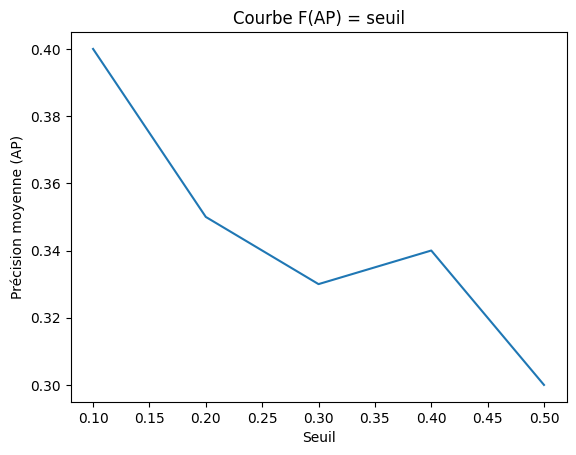

In [ ]:
import matplotlib.pyplot as plt

# Liste des seuils
thresholds = [0.1, 0.2, 0.3, 0.4, 0.5]

# Liste des valeurs de précision moyenne (AP)
AP_values = [0.40, 0.35, 0.33, 0.34, 0.3]

# Tracer la courbe F(AP) = seuil
plt.plot(thresholds, AP_values)

# Ajouter des étiquettes aux axes et un titre
plt.xlabel('Seuil')
plt.ylabel('Précision moyenne (AP)')
plt.title('Courbe F(AP) = seuil')

# Afficher le graphique
plt.show()
